# Transformers and SentenceTransformers 

This notebook has been adapated from an earlier version by the [AI for Humanists](https://aiforhumanists.com/) team. 

## In This Notebook

We're going to be looking at word- and document-level embedding generation using `transformers`. Remember that while word2vec-style *static* word embedding models generate a single word embedding for each word in their training data, transformer-based language models generate a *distinct embedding for every word in a sequence, that varies based on the content of the sequence*. This is very powerful. 

We'll first go step-by-step through how to get word-level embeddings using BERT, visualizing our results using methods we should already be familiar with. Then, we'll briefly introduce SentenceTransformers, a package that simplifies document embedding generation using `transformers` models. 


## **Import necessary Python libraries and modules**


We import the DistilBertModel and DistilBertTokenizerFast from the Hugging Face `transformers` library. We also import a handful of other Python libraries and modules.

In [1]:
# new
from   transformers import DistilBertTokenizerFast, DistilBertModel

# others
import numpy as np
import os
import pandas as pd
import re
from   sklearn.decomposition import PCA

pd.options.display.max_colwidth = 200

## **Load text dataset**

Our dataset contains around 30,000 poems scraped from  http://public-domain-poetry.com/. This website hosts a curated collection of poems that have fallen out of copyright, which makes them easier to share.
You can find the data in the AI for Humanists [GitHub repository](https://github.com/melaniewalsh/BERT-4-Humanists/blob/main/data/public-domain-poetry.csv).

We don't have granular date information about when each poem was published, but we do know the birth dates of most of our authors, which we've used to loosely categorize the poems by time period. The poems in our data range from the Middle Ages to the twentieth century, but most come from the nineteenth century. The data features both well-known authors — William Wordsworth, Emily  Dickinson, Paul Laurence Dunbar, Walt Whitman, Shakespeare — as well as less well-known authors.

In [2]:
# read poems from b4h github repo
url = "https://raw.githubusercontent.com/melaniewalsh/BERT-4-Humanists/main/data/public-domain-poetry.csv"
poetry_df = pd.read_csv(url, encoding='utf-8')
poetry_df.sample(5)

,author,title,text,lifespan,birth_year,death_year,link,period
20105,Robert Burns,To Mr. Syme. With A Present Of A Dozen Of Porter,"O, had the malt thy strength of mind,\r\nOr hops the flavour of thy wit,\r\n'Twere drink for first of human kind,\r\nA gift that e'en for Syme were fit.\n\r\nJerusalem Tavern, Dumfries.",25 January 1759-21 July 1796,1759.0,1796.0,http://public-domain-poetry.com/robert-burns/to-mr-syme-with-a-present-of-a-dozen-of-porter-10081,18th Century
877,Alfred Lichtenstein,Kuno Kohn's Five Songs to Mary,"First Song:\n\r\nSo many years I sought you, Mary - \r\nIn gardens, rooms, cities and mountains,\r\nIn dumps, whores, in acting schools,\r\nIn sick beds and in the rooms of mad people,\r\nIn kitch...",23rd August 1889 - 25th September 1914,1889.0,1914.0,http://public-domain-poetry.com/alfred-lichtenstein/kuno-kohns-five-songs-to-mary-23901,20th Century
21432,Robert Herrick,"Lines Have Their Linings, And Books Their Buckram","As in our clothes, so likewise he who looks,\r\nShall find much farcing buckram in our books.","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/lines-have-their-linings-and-books-their-buckram-18937,16th-17th Centuries (Early Modern)
7471,Francesco Petrarca (Petrarch),Sonnet XV,"Piovonmi amare lagrime dal viso.\n\r\nHIS STATE WHEN LAURA IS PRESENT, AND WHEN SHE DEPARTS.\n\n\r\nDown my cheeks bitter tears incessant rain,\r\nAnd my heart struggles with convulsive sighs,\r\n...","July 20, 1304-July 19, 1374",1304.0,1374.0,http://public-domain-poetry.com/francesco-petrarca/sonnet-xv-28410,12th-15th Centuries (Middle English)
15936,Madison Julius Cawein,A.D. Nineteen Hundred,"War and Disaster, Famine and Pestilence,\r\nVaunt-couriers of the Century that comes,\r\nBehold them shaking their tremendous plumes\r\nAbove the world! where all the air grows dense\r\nWith rumor...",23 March 1865 - 8 December 1914,1865.0,1914.0,http://public-domain-poetry.com/madison-julius-cawein/ad-nineteen-hundred-11259,19th Century


In [3]:
# count of poems
len(poetry_df)

31080

In [4]:
# top authors
poetry_df['author'].value_counts()[:20]

author
Robert Herrick                   1464
Madison Julius Cawein            1345
William Wordsworth                963
Thomas Moore                      853
Thomas Hardy                      655
Rudyard Kipling                   638
Robert Burns                      499
John Greenleaf Whittier           481
Algernon Charles Swinburne        461
Emily Elizabeth Dickinson         447
Paul Laurence Dunbar              417
John Clare                        382
William Butler Yeats              378
Francesco Petrarca (Petrarch)     375
Paul Cameron Brown                341
Walt Whitman                      338
Edgar Lee Masters                 331
Percy Bysshe Shelley              330
Oliver Wendell Holmes             329
Walter De La Mare                 329
Name: count, dtype: int64

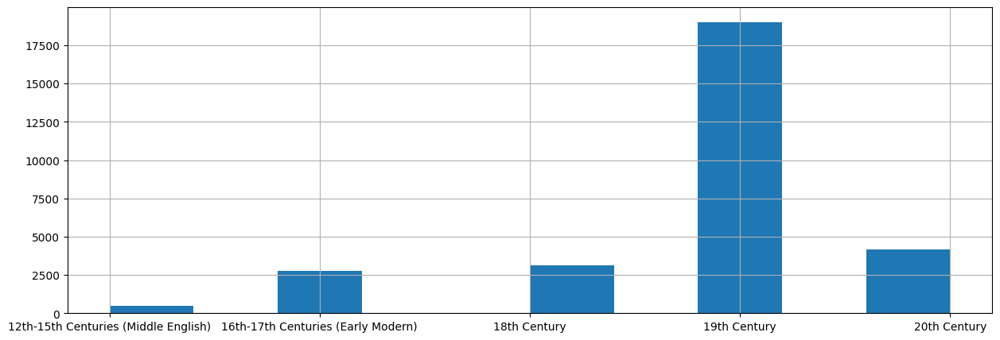

In [5]:
# vis counts by period
poetry_df['period'].sort_values().hist(figsize=(15, 5));

## **Sample text dataset**

To reduce the number of poems to a more workable (and balanced) amount, we will take a random sample of 1,000 poems from four different time periods: the 20th Century, 19th Century, 18th Century, and the Early Modern period.

In [6]:
# Filter the DataFrame for only a given time period, then randomly sample 1000 rows
nineteenth_sample = poetry_df[poetry_df['period'] == '19th Century'].sample(1000)
twentieth_sample = poetry_df[poetry_df['period'] == '20th Century'].sample(1000)
eighteenth_sample = poetry_df[poetry_df['period'] == '18th Century'].sample(1000)
sixteenth_sample = poetry_df[poetry_df['period'] == '16th-17th Centuries (Early Modern)'].sample(1000)

In [7]:
# Merge these random samples into a new DataFrame
poetry_df = pd.concat([sixteenth_sample, eighteenth_sample, twentieth_sample, nineteenth_sample])

In [8]:
poetry_df['period'].value_counts()

period
16th-17th Centuries (Early Modern)    1000
18th Century                          1000
20th Century                          1000
19th Century                          1000
Name: count, dtype: int64

Finally, let's make a list of poems from our Pandas DataFrame.

In [9]:
poetry_texts = poetry_df['text'].tolist()

Let's examine a poem in our dataset:

In [10]:
len(poetry_texts)

4000

In [13]:
print(poetry_texts[1])

Tumble me down, and I will sit
Upon my ruins, smiling yet;
Tear me to tatters, yet I'll be
Patient in my necessity.
Laugh at my scraps of clothes, and shun
Me, as a fear'd infection;
Yet, scare-crow-like, I'll walk as one
Neglecting thy derision.


## **Encode/tokenize text data for BERT**

Next we need to transform our poems into a format that BERT (via Huggingface) will understand. This is called *tokenizing* the data.

We will tokenize the poems with the `tokenizer()` from HuggingFace's `DistilBertTokenizerFast`. Here's what the `tokenizer()` will do:

1. Truncate the texts if they're more than 512 tokens or pad them if they're fewer than 512 tokens. If a word is not in BERT's vocabulary, it will be broken up into smaller "word pieces," demarcated by a `##`.

2. Add in special tokens to help BERT:
    - [CLS] — Start token of every document
    - [SEP] — Separator between each sentence
    - [PAD] — Padding at the end of the document as many times as necessary, up to 512 tokens
    - &#35;&#35; — Start of a "word piece"

Here we will load `DistilBertTokenizerFast` from `transformers` library, which will help us transform and encode the texts so they can be used with BERT.

This `tokenizer` is very different from the tokenizers we have encountered earlier. Notably, it is a *subword tokenizer*, which "splits up" words into multiple subword tokens. Let's take a look at how that shakes out in practice:

In [14]:
tokenizer = DistilBertTokenizerFast.from_pretrained('distilbert-base-uncased')

The `tokenizer()` will break word tokens into word pieces, truncate to 512 tokens, and add padding (if necessary) and special BERT tokens.

In [15]:
tokenized_example = tokenizer(poetry_texts[0:2], truncation=True, padding=True, return_tensors="pt")

Let's examine the first tokenized poem. We can see that the special BERT tokens have been inserted where necessary and that some words are "split" into multiple subword units:

In [16]:
tokenized_example[0]

Encoding(num_tokens=73, attributes=[ids, type_ids, tokens, offsets, attention_mask, special_tokens_mask, overflowing])

In [17]:
tokenized_example

{'input_ids': tensor([[  101,  2023,  3203,  1005,  1055,  2460,  1010,  2008, 10414,  2016,
          2003,  4206,  1025,  2021,  2146,  2030,  2460,  1010,  1045,  1005,
          1049,  2092,  4180,  2007,  2035,  1012,   102,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0],
        [  101, 28388,  2033,  2091,  1010,  1998,  1045,  2097,  4133,  2588,
          2026,  8435,  1010,  5629,  2664,  1025,  7697,  2033,  2000, 11937,
         24168,  1010,  2664,  1045,  1005,  2222,  2022,  5776,  1999,  2026,
         13185,  1012,  4756,  2012,  2026, 15121,  2015,  1997,  4253,  1010,
          1998, 18454,  2078,  2033,  1010,  2004,  1037,  3571,  1005,  1040,
       

In [19]:
' '.join(tokenized_example[1].tokens)

"[CLS] tumble me down , and i will sit upon my ruins , smiling yet ; tear me to ta ##tters , yet i ' ll be patient in my necessity . laugh at my scrap ##s of clothes , and shu ##n me , as a fear ' d infection ; yet , scare - crow - like , i ' ll walk as one neglect ##ing thy der ##ision . [SEP]"

Some words above are kept as single tokens, while others are split up. In practice, this means that BERT will almost always be able to represent a word, even a word it hasn't seen before, by simply merging existing tokens together. word2vec, by contrast, cannot do this, since the mapping from words to vocabulary items is one-to-one. 

However, if you want to get a single word embedding from a multi-token word, you will need to combine the representations of these tokens in some way (usually mean pooling). In other words, each subword token will result in its own subword embedding, so you will need to combine subword embeddings to get a single word embedding out. 

## Keeping Track of Spans

Later on, we're going to want to generate embeddings for words across many sequences. The `Tokenizer` base class in HuggingFace `transformers` returns an `Encoding` object that has some convenience functions for doing this. However, we need the index of the word (more precisely, a charracter in the word) in order to find its associated token in the tokenized sequence. Below, we have written some functions to help do that.

In [20]:
from collections import namedtuple

# Let's define a named tuple to make indexing clearer
Span = namedtuple("Span", ["idx", "start", "stop"])

def get_char_idx_for_word(seqs, word) -> Span:
    char_spans = []
    pattern = re.compile(rf"\b{word}\b", re.IGNORECASE)
    for i, seq in enumerate(seqs): 
        for match in re.finditer(pattern, seq):
            span = match.span()
            char_spans.append(Span(i, span[0], span[1])) 
    return char_spans

def get_token_idx_for_char_idx(all_encodings, char_spans) -> tuple[Span, Span]:
    tok_spans = []
    kept_char_spans = []
    for span in char_spans:
        sample = all_encodings[span.idx]
        start = sample.char_to_token(span.start)
        stop = sample.char_to_token(span.stop - 1)
        if all([start, stop]): # Don't include cases where the word has been truncated 
            tok_spans.append(Span(span.idx, start, stop+1))
            kept_char_spans.append(span) # Keep track of which char spans we actually use
    return tok_spans, kept_char_spans

In [21]:
# Note for lecture: find a word that's actually in a sample!

example_char_span = get_char_idx_for_word(poetry_texts[0:2], "tatters")
example_char_span

[Span(idx=1, start=72, stop=79)]

In [22]:
example_token_span, _ = get_token_idx_for_char_idx(tokenized_example, example_char_span)
example_token_span = example_token_span[0]

# Ugly indexing syntax
tokenized_example[example_token_span.idx].tokens[example_token_span.start:example_token_span.stop] 

['ta', '##tters']

For context, here's how big the `tokenizer` vocab is and what it looks like: 

In [23]:
len(tokenizer.vocab)

30522

In [24]:
tokenizer.vocab

{'castle': 3317,
 'film': 2143,
 'venture': 6957,
 '##rka': 22379,
 'products': 3688,
 'therapy': 7242,
 'entry': 4443,
 'commerce': 6236,
 '##ute': 10421,
 'nathan': 7150,
 'ʊ': 1132,
 'stocked': 24802,
 'mines': 7134,
 '[unused168]': 173,
 '##ym': 24335,
 'request': 5227,
 'representatives': 4505,
 'texans': 23246,
 'dust': 6497,
 'steppe': 29096,
 'reich': 14365,
 'taylor': 4202,
 'jen': 15419,
 'sparta': 21251,
 'chilean': 12091,
 'groans': 27778,
 '196': 20035,
 'deployed': 7333,
 'establishments': 17228,
 'scrub': 18157,
 'mourning': 16236,
 'augusto': 29085,
 '⊕': 1612,
 'devastated': 13879,
 'write': 4339,
 'alfa': 22989,
 'stark': 9762,
 '##clave': 23650,
 'militant': 16830,
 'tuba': 29242,
 'enveloped': 25407,
 '##tton': 15474,
 '##owski': 15249,
 'lark': 23404,
 'bizarre': 13576,
 'diseases': 7870,
 'gottfried': 26142,
 'fueled': 17999,
 '清': 1903,
 'goddamn': 16477,
 'vidal': 29259,
 'er': 9413,
 'night': 2305,
 '[unused214]': 219,
 'controllers': 21257,
 'det': 20010,
 'mo

## **Load pre-trained BERT model**

Here we will load a pre-trained BERT model. To speed things up we will use a GPU, but using GPU involves a few extra steps.
The command `.to("cuda")` moves data from regular memory to the GPU's memory.




In [25]:
#device = 'mps' # apple silicon gpu
device = 'cuda' # nvidia gpu, what you'd probably use on Colab
#device = 'cpu' # pretty slow

In [26]:
model = DistilBertModel.from_pretrained('distilbert-base-uncased').to(device)

In [27]:
# check device in use
model.device

device(type='cuda', index=0)

## **Get BERT word embeddings for each document in a collection**

Because BERT processes text as an ordered sequence of tokens, we have essentially introduced a dimension that we normally haven't had consider when vectorizing or processing text data.

Our tokenized poems have shape $(N, L)$, where $N$ is the batch size (how many poems are processed in parallel), $L$ is the sequence length in tokens (padded/truncated to the same length for each sample in $N$). Our outputs from then model will have shape $(N, L, E)$, where $E$ is the model's embedding dimensionality.

To keep things simple here, we'll keep $N=1$ in the example below. Having a higher batch size when generating embeddings can help speed things up sometimes, but it really doesn't matter for us at the moment. 

In [28]:
from tqdm import tqdm

# One Encoding per poem. Not working batch-wise here, just to keep things simple.
# We tokenize each poem individually and keep them in a big list that we can reference later.
tokenized_texts = [tokenizer(t, return_tensors="pt", truncation=True) for t in poetry_texts]

# We'll store all the word vectors generated by BERT here.
poetry_vectors = []

for encoding in tqdm(tokenized_texts):
    model.eval()
    outputs = model(**encoding.to(device))
    # Grabbing the last layer is one way of getting token vectors. There are different ways to get vectors with different pros and cons
    #                                               Shape:  | Forget | move   | convert
    #                                              (N, L, E)| grads ,| to CPU,| to numpy
    #                                               v  v  v |   v       v       v
    poetry_vectors.append(outputs.last_hidden_state[0, :, :].detach().cpu().numpy())

del model
del outputs


100%|██████████| 4000/4000 [00:26<00:00, 148.43it/s]


Confirm that we have the same number of documents for both the tokens and the vectors:

In [29]:
print(len(tokenized_texts), len(poetry_vectors))

4000 4000


## **Find words**

Let's look at a classic example: "bank". First, we need to use the functions we defined earlier to get the character and token spans for "bank". We will probably also want to use the metadata for our poems later as well.

In [30]:
bank_char_spans = get_char_idx_for_word(poetry_texts, "bank")
bank_tok_spans, bank_char_spans = get_token_idx_for_char_idx(tokenized_texts, bank_char_spans)

bank_df = poetry_df.iloc[[s.idx for s in bank_tok_spans]].copy()

bank_df.head()

,author,title,text,lifespan,birth_year,death_year,link,period
28314,William Browne,An Angler,"Now as an angler melancholy standing\r\nUpon a green bank yielding room for landing,\r\nA wriggling yellow worm thrust on his hook,\r\nNow in the midst he throws, then in a nook:\r\nHere pulls his...",1591 -? 1645,1591.0,1645.0,http://public-domain-poetry.com/william-browne/an-angler-36470,16th-17th Centuries (Early Modern)
20398,Robert Herrick,Oberon's Palace,"After the feast, my Shapcot, see\r\nThe fairy court I give to thee;\r\nWhere we'll present our Oberon, led\r\nHalf-tipsy to the fairy bed,\r\nWhere Mab he finds, who there doth lie,\r\nNot without...","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/oberons-palace-18864,16th-17th Centuries (Early Modern)
13553,John Milton,Paradise Regained - The Second Book,"Mean while the new-baptiz'd, who yet remain'd\r\nAt Jordan with the Baptist, and had seen\r\nHim whom they heard so late expresly call'd\r\nJesus Messiah Son of God declar'd,\r\nAnd on that high A...","December 9, 1608-November 8, 1674",1608.0,1674.0,http://public-domain-poetry.com/john-milton/paradise-regained-the-second-book-8323,16th-17th Centuries (Early Modern)
20738,Robert Herrick,A Song Upon Silvia,"From me my Silvia ran away,\r\nAnd running therewithal\r\nA primrose bank did cross her way,\r\nAnd gave my love a fall.\n\r\nBut trust me now, I dare not say\r\nWhat I by chance did see;\r\nBut s...","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/song-upon-silvia-19163,16th-17th Centuries (Early Modern)
20790,Robert Herrick,The Wassail,"Give way, give way, ye gates, and win\r\nAn easy blessing to your bin\r\nAnd basket, by our entering in.\n\r\nMay both with manchet stand replete;\r\nYour larders, too, so hung with meat,\r\nThat ...","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/wassail-2307,16th-17th Centuries (Early Modern)


Let's write a function to get a little window of context around the word we're interested in. That way, we can maybe get a sense of what the overall sequence is about after we get our word embedding out from the model.

In [31]:
def get_context(texts, spans, before=20, after=20):
    contexts = []
    for s in spans:
        sample = texts[s.idx]
        before_idx = max(0, s.start - before)
        after_idx = s.stop + after + 1

        context = sample[before_idx:after_idx]
        context = re.sub('[^A-Za-z0-9]+', ' ', context).strip() # get rid of unreadable escaped sequences
        contexts.append(f"...{context}...")
    
    return contexts

bank_df["contexts"] = get_context(poetry_texts, bank_char_spans)

bank_df

,author,title,text,lifespan,birth_year,death_year,link,period,contexts
28314,William Browne,An Angler,"Now as an angler melancholy standing\r\nUpon a green bank yielding room for landing,\r\nA wriggling yellow worm thrust on his hook,\r\nNow in the midst he throws, then in a nook:\r\nHere pulls his...",1591 -? 1645,1591.0,1645.0,http://public-domain-poetry.com/william-browne/an-angler-36470,16th-17th Centuries (Early Modern),...nding Upon a green bank yielding room for la...
20398,Robert Herrick,Oberon's Palace,"After the feast, my Shapcot, see\r\nThe fairy court I give to thee;\r\nWhere we'll present our Oberon, led\r\nHalf-tipsy to the fairy bed,\r\nWhere Mab he finds, who there doth lie,\r\nNot without...","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/oberons-palace-18864,16th-17th Centuries (Early Modern),...Track they redeem a bank of moss Spongy and...
13553,John Milton,Paradise Regained - The Second Book,"Mean while the new-baptiz'd, who yet remain'd\r\nAt Jordan with the Baptist, and had seen\r\nHim whom they heard so late expresly call'd\r\nJesus Messiah Son of God declar'd,\r\nAnd on that high A...","December 9, 1608-November 8, 1674",1608.0,1674.0,http://public-domain-poetry.com/john-milton/paradise-regained-the-second-book-8323,16th-17th Centuries (Early Modern),...vain Then on the bank of Jordan by a Cree...
20738,Robert Herrick,A Song Upon Silvia,"From me my Silvia ran away,\r\nAnd running therewithal\r\nA primrose bank did cross her way,\r\nAnd gave my love a fall.\n\r\nBut trust me now, I dare not say\r\nWhat I by chance did see;\r\nBut s...","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/song-upon-silvia-19163,16th-17th Centuries (Early Modern),...ewithal A primrose bank did cross her way...
20790,Robert Herrick,The Wassail,"Give way, give way, ye gates, and win\r\nAn easy blessing to your bin\r\nAnd basket, by our entering in.\n\r\nMay both with manchet stand replete;\r\nYour larders, too, so hung with meat,\r\nThat ...","Baptized - August 24, 1591- October 1674",1591.0,1674.0,http://public-domain-poetry.com/robert-herrick/wassail-2307,16th-17th Centuries (Early Modern),...lemn sober stream Bank d all with lilies a...
30251,William Wordsworth,The Excursion. Note & Preface,"Something must now be said of this poem, but chiefly, as has been done through the whole of these notes, with reference to my personal friends, and especially to her who has perseveringly taken th...","April 7, 1770-April 23, 1850",1770.0,1850.0,http://public-domain-poetry.com/william-wordsworth/excursion-note-preface-4208,18th Century,...residence at Allan Bank The long poem on my...
29372,William Hayley,The Swan,"Kind Heaven will oft a lesson give\r\nIf mortals are inclined to learn;\r\n To shew how simplest things that live,\r\nTo kindness make a rich return.\n\r\n Tho' fiction speaks of dying notes,\r\n...","November 9, 1745 - November 12, 1820",1745.0,1820.0,http://public-domain-poetry.com/william-hayley/swan-18239,18th Century,...a liv d on Thames s bank A young and lovely...
19971,Robert Burns,The Vision,"Duan First.[1]\n\n\r\nThe sun had clos'd the winter day,\r\nThe curlers quat their roaring play,\r\nAn' hunger'd maukin ta'en her way\r\nTo kail-yards green,\r\nWhile faithless snaws ilk step betr...",25 January 1759-21 July 1796,1759.0,1796.0,http://public-domain-poetry.com/robert-burns/vision-9913,18th Century,...Or strutted in a bank an clarkit My cash...
30168,William Wordsworth,"Solitude, Or Lucy Gray","Oft I had heard of Lucy Gray:\r\n And, when I crossed the wild,\r\n I chanced to see at break of day\r\n The solitary child.\n\r\n No mate, no comrade Lucy knew;\r\n She dwelt on a wide moor,\r\n...","April 7, 1770-April 23, 1850",1770.0,1850.0,http://public-domain-poetry.com/william-wordsworth/solitude-or-lucy-gray-4159,18th Century,...owed from the snowy bank Those footmarks o...
2027,Anna Seward,Sonnet LXXVII,"O!

## Visualizing word embeddings

Finally, let's get our embedding out of each sequence of word embeddings we've generated earlier...

In [32]:
def get_word_embeddings(all_embeddings, token_spans):
    word_embeddings = []
    for s in token_spans:
        word = all_embeddings[s.idx][s.start:s.stop].mean(axis=0) # Mean pool all token embeddings
        word_embeddings.append(word)
    
    return np.vstack(word_embeddings)

bank_embeddings = get_word_embeddings(poetry_vectors, bank_tok_spans)

# We'll normalize them too
bank_embed_norm = np.sqrt((bank_embeddings**2).sum(axis=1, keepdims=True))
bank_embeddings = bank_embeddings / bank_embed_norm


In [34]:
bank_embeddings.shape

(47, 768)

Get a 2-D version of each embedding with PCA...

In [33]:
bank_pca = PCA(n_components=2).fit_transform(bank_embeddings)
bank_df["pca_x"] = bank_pca[:, 0]
bank_df["pca_y"] = bank_pca[:, 1]

and visualize with a scatterplot.

<Axes: xlabel='pca_x', ylabel='pca_y'>

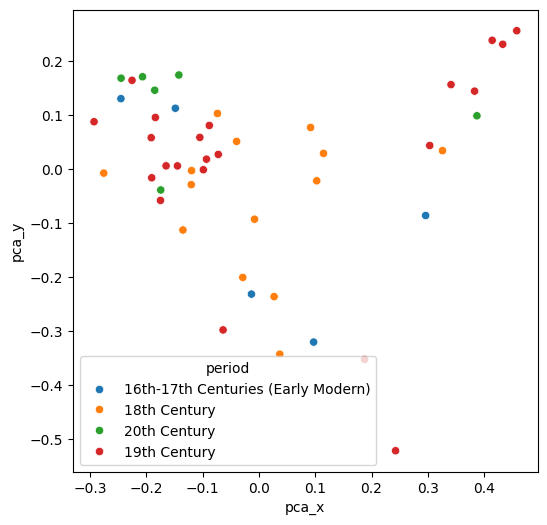

In [35]:
import seaborn as sns
from matplotlib import pyplot as plt

plt.subplots(figsize=(6, 6))

sns.scatterplot(
    data=bank_df,
    x="pca_x",
    y="pca_y",
    hue="period"
)

Not the most interesting scatterplot you've ever seen, but now we can at least see that the word-level representation of "bank" varies (quite a bit) given the context in the sequence. With word2vec, we would have been stuck with just one vector for the word. Pretty neat!

Let's build a pipeline that can perform this visualization for any term we want, and maybe check a few different terms live in class!

In [36]:
import altair as alt  # Using altair here
alt.renderers.enable('mimetype')


def visualization_pipeline(vectors, 
                           encodings,
                           dataframe, 
                           texts, 
                           word):
    # Get char span
    char_spans = get_char_idx_for_word(texts, word)
    tok_spans, char_spans = get_token_idx_for_char_idx(encodings, char_spans)
    
    contexts = get_context(texts, char_spans, before=25, after=25)
    word_df = dataframe.iloc[[s.idx for s in char_spans]].copy()
    word_df["context"] = contexts

    word_embeddings = get_word_embeddings(vectors, tok_spans)
    norm = np.sqrt((word_embeddings**2).sum(axis=1, keepdims=True))
    word_embeddings /= norm 
    print(f"Total number of words embedded: {word_embeddings.shape[0]}")

    word_pca = PCA(n_components=2).fit_transform(word_embeddings)
    word_df["pca_x"] = word_pca[:, 0]
    word_df["pca_y"] = word_pca[:, 1]

    scatter = (             # I used AI to help with this, since I don't know Altair very well
        alt.Chart(word_df)
        .mark_circle(size=60)
        .encode(
            x='pca_x:Q',
            y='pca_y:Q',
            tooltip=[
                alt.Tooltip('context:N', title='Context'),
                alt.Tooltip('author:N', title='Author'),
                alt.Tooltip('title:N', title='Title')
            ],
            color=alt.Color("period:N", title="Period")
        )
        .properties(width=600, height=600)
        .interactive()  
    )

    # Seaborn without interactivity, if Altair gives you problems.
    #scatter = sns.scatterplot(data=word_df, x="pca_x", y="pca_y", hue="period") 

    return scatter, word_df

In [46]:
# plt.subplots(figsize=(10, 8))
scatter, word_df = visualization_pipeline(poetry_vectors, tokenized_texts, poetry_df, poetry_texts, "love")
scatter

Total number of words embedded: 1902


<VegaLite 5 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/display_frontends.html#troubleshooting


## SentenceTransformers for Document-level Embeddings

You can get some great insights looking at BERT's word embeddings and how their representations change given different contexts. However, like we've been doing throughout the semester, you might just want to represent an entire sequence as a document vector, or document embedding. 

Luckily, there are plenty of transformers that are designed to do exactly that! Even more luckily, the [SentenceTransformers](https://www.sbert.net/) library has made this all very convenient. If you have strings, you can generate document embeddings in just a couple lines, like so:

In [41]:
from sentence_transformers import SentenceTransformer



st_model = SentenceTransformer("all-minilm-l6-v2")  # A very small model
poem_embeddings = st_model.encode(poetry_texts, show_progress_bar=True, normalize_embeddings=True)

del st_model


Batches:   0%|          | 0/125 [00:00<?, ?it/s]

In [43]:
poem_embeddings.shape

(4000, 384)

In [44]:
pca_poems = PCA(n_components=2).fit_transform(poem_embeddings)

poetry_df["pca_x"] = pca_poems[:, 0]
poetry_df["pca_y"] = pca_poems[:, 1]

(alt.Chart(poetry_df)
 .mark_circle(size=60, fillOpacity=.5)
 .encode(
    x='pca_x:Q',
    y='pca_y:Q',
    tooltip=[
        alt.Tooltip('author:N', title='Author'),
        alt.Tooltip('title:N', title='Title')
    ],
    color=alt.Color("period:N", title="Period")
)
.properties(width=600, height=600)
.interactive()  
)

<VegaLite 5 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/display_frontends.html#troubleshooting


Let's try a completely different model, maybe one that's more powerful.

In [45]:
st_model = SentenceTransformer("BAAI/bge-base-en-v1.5")  # A larger, newer model
poem_embeddings = st_model.encode(poetry_texts, show_progress_bar=True, normalize_embeddings=True)

pca_poems = PCA(n_components=2).fit_transform(poem_embeddings)

poetry_df["pca_x"] = pca_poems[:, 0]
poetry_df["pca_y"] = pca_poems[:, 1]

(alt.Chart(poetry_df)
 .mark_circle(size=60, fillOpacity=.5)
 .encode(
    x='pca_x:Q',
    y='pca_y:Q',
    tooltip=[
        alt.Tooltip('author:N', title='Author'),
        alt.Tooltip('title:N', title='Title')
    ],
    color=alt.Color("period:N", title="Period")
)
.properties(width=600, height=600)
.interactive()  
)

Batches:   0%|          | 0/125 [00:00<?, ?it/s]

<VegaLite 5 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/display_frontends.html#troubleshooting


We'll be using SentenceTransformer models quite a bit for the remainder of the course. You should know that SentenceTransformers is essentially just a wrapper for the `transformers` package, but you can use the same underlying language model the same way we did with BERT. 